# Detection Network: Master Train

This is the "master-configuration" training of the complete detection-network (both Resnet-based feature-extractor and RPN+location head).

Since **the output of this notebook is intended to be used for detection henceforce in this project**, and since the training configuration was previously tested, the training here uses all the available labeled data (with no validation set).

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import DetectorNetwork as dn

import os, sys, time, datetime, random
from pathlib import Path
from warnings import warn
from tqdm import tqdm, tnrange, tqdm_notebook
import pickle as pkl
import gc

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns
from collections import Counter, OrderedDict
import cv2
from PIL import Image

import torch as t
from torch import nn
from torch.nn import functional as F
from torch.autograd import Variable
from torch import optim

In [3]:
mpl.rcParams.update({'font.size': 14})

In [4]:
MODELS_PATH = Path('models')
HEAD_NAME = 'head_13images.mdl'
SAVE_MODEL = HEAD_NAME
LOAD_MODEL = None # HEAD_NAME

## Head Training


Experiment:	Master
(291600, 13) (291600, 4, 13) (291600, 4)
Param-groups to set grad for: 48
Feature-map shape: torch.Size([1, 128, 135, 240])
Feature size: 8
Features shape:
Without location:	 torch.Size([1, 128, 135, 240])
	4<=x0<=1916, 4<=y0<=1076
With location:	 torch.Size([1, 130, 135, 240])
Network channels: 128 -> (skipped) -> 128 -> 45
Total params:	153457
Param-groups to set grad for: 10
Train/valid images:	13 / 1



(39, 5)


,experiment,image,out_of_sample,loss_type,loss
0,Master,0,False,Bkg detection,0.000011
1,Master,1,False,Bkg detection,0.000017
2,Master,2,False,Bkg detection,0.000019


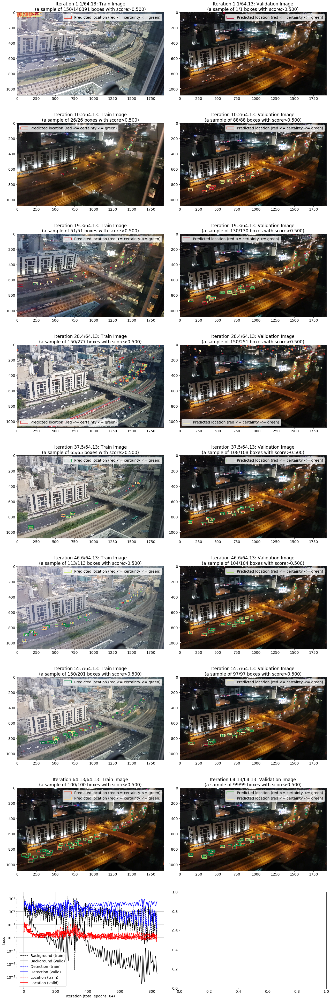

In [5]:
# train head
# note: "validation set" is not really out-of-sample this time
head_loss = dn.experiment_instance(exp_name='Master', models_path=MODELS_PATH, save_model=SAVE_MODEL, load_model=LOAD_MODEL,
                                   i_train=list(range(13)), i_valid=[12], train_plot_freq=7, verbose=2, seed=None)
print(head_loss.shape)
head_loss.head(3)

## Complete-Network Training

In [6]:
# reload head
head = dn.RPN(in_channels=128, loc_features=True, verbose=True)
head.load_state_dict(t.load(MODELS_PATH/HEAD_NAME))

# wrap head along with feature-extractor
conv = dn.get_resnet_conv_model()
model = dn.DetectionNetwork(conv, head)

Network channels: 128 -> (skipped) -> 128 -> 45


In [7]:
# load data & labels for display
files, images, W, H, _ = dn.get_training_images(verbose=False)
inputs = dn.ims2vars(images, verbose=False)
labels, locations, anchors = dn.get_training_labels()
anchor_locs = dn.get_anchors_location_map(anchors)
loc_fac = dn.LocationFactory(anchors, H, W)

(291600, 13) (291600, 4, 13) (291600, 4)


In [8]:
full_optimizer = optim.Adam(model.parameters())

Train/valid images:	13 / 1


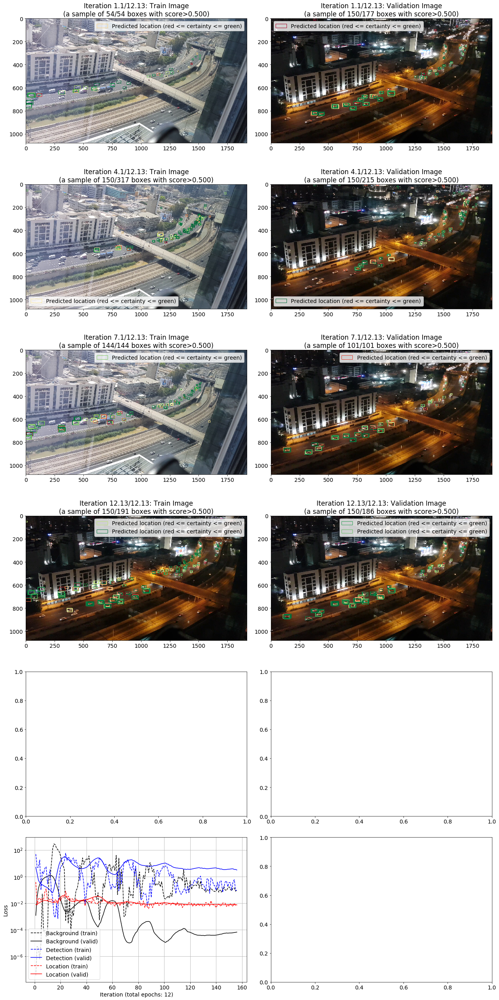

In [9]:
losses = \
    dn.train_model(model, full_optimizer, images, inputs, labels, locations, loc_fac, anchor_locs,
                   epochs=12, lr=0.0003, bs=64, lab2loc_loss_ratio=20, object_overweight=1/5,
                   i_train=list(range(13)), i_valid=[12], verbose=1, plot_freq=4)

In [10]:
t.save(model.state_dict(), MODELS_PATH/'model_13images.mdl')

#### Compare freezed to un-freezed

In [11]:
head0 = dn.RPN(in_channels=128, loc_features=True)
head0.load_state_dict(t.load(MODELS_PATH/HEAD_NAME))
conv0 = dn.get_resnet_conv_model()
model0 = dn.DetectionNetwork(conv0, head0)

Network channels: 128 -> (skipped) -> 128 -> 45


In [12]:
res = dn.summarize_experiment('Freezed', model0, images, inputs, labels, locations,
                              20, 1/10, list(range(13)), anchor_locs=anchor_locs, loc_fac=loc_fac)
res = pd.concat((res, dn.summarize_experiment('Un-freezed', model, images, inputs, labels, locations,
                                              20, 1/10, list(range(13)), anchor_locs=anchor_locs, loc_fac=loc_fac) ))

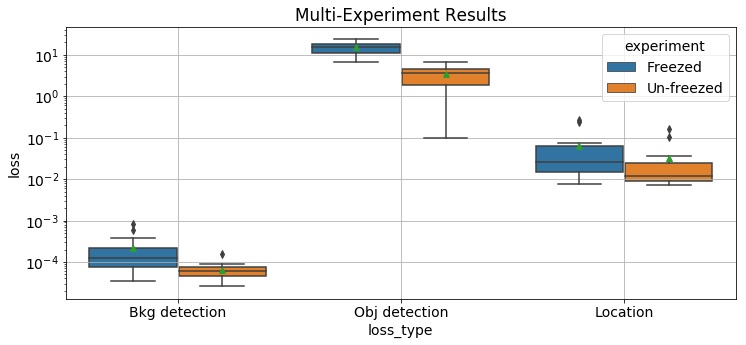

In [13]:
plt.figure(figsize=(12,5))
sns.boxplot(data=res, x='loss_type', y='loss', hue='experiment', showmeans=True)
plt.title('Multi-Experiment Results')
plt.yscale('log')
plt.grid()

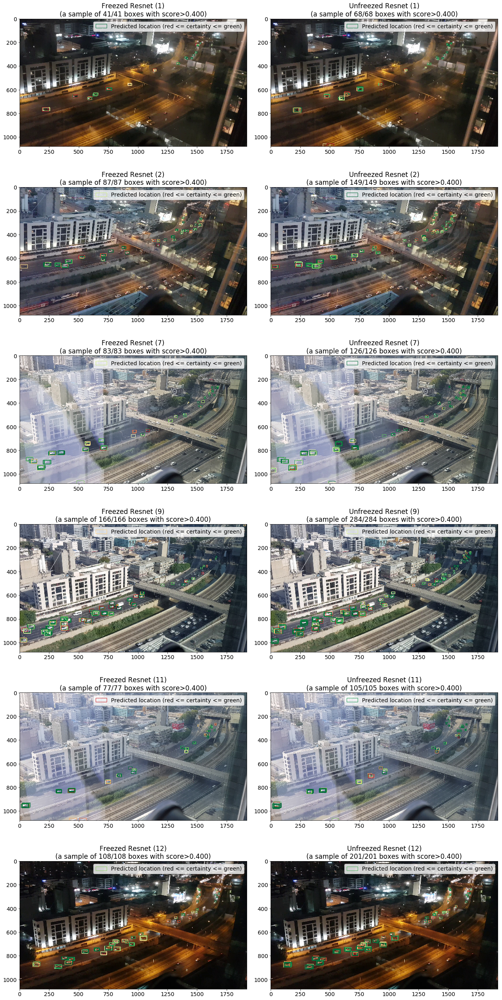

In [14]:
dn.compare_preds(model0, model, images, inputs, labels, locations, anchor_locs, loc_fac,
                 thresh=0.4, ids=(1,2,7,9,11,12), models_names=('Freezed Resnet','Unfreezed Resnet'))

#### Show final results

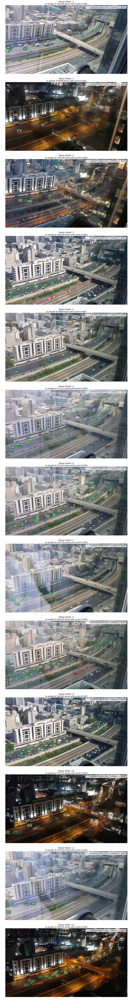

In [15]:
# show model final predictions
_, axs = plt.subplots(13,1, figsize=(18,13*10))

for i in range(13):
    X, tmp_labs, tmp_locs, anchor_locs = dn.to_device(model, [inputs[i], labels[:,i], locations[:,:,i], anchor_locs])
    with t.no_grad():
        labs, locs = model.eval()(X, anchor_locs)
    ax = axs[i]
    dn.show_preds(labs, locs, loc_fac, image=images[i], thresh=0.4,
                  n_display=np.Inf, ax=ax, title=f'Master Model / {i:d}')
    dn.clean_device([X, tmp_labs, tmp_locs])
    ax.axis('off')

plt.tight_layout()